# Inference Hubmap - HPA - TPU - Noisy EfficientNet B8

Copied from: https://www.kaggle.com/code/markwijkhuizen/hubmap-inference-tf-tpu-efficientnet-b7-640x640/notebook

In [1]:
# Import EfficientNet models with intermediate endpoints
import sys
sys.path.append('../input/model-noisy-student-efficientnetb8/efficientnetv2/')
sys.path.append('../input/model-noisy-student-efficientnetb8/')

In [2]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow_addons as tfa
import matplotlib.pyplot as plt

from tensorflow.keras.mixed_precision import experimental as mixed_precision
from kaggle_datasets import KaggleDatasets
from tqdm.notebook import tqdm
from multiprocessing import cpu_count
from sklearn import metrics
from sklearn.model_selection import KFold

import tifffile
import re
import os
import io
import time
import pickle
import math
import random
import sys
import cv2
import gc

from efficientnetv2 import effnetv2_model

print(f'tensorflow version: {tf.__version__}')
print(f'tensorflow keras version: {tf.keras.__version__}')
print(f'python version: P{sys.version}')

2022-09-22 14:08:15.693373: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


tensorflow version: 2.4.1
tensorflow keras version: 2.4.0
python version: P3.7.10 | packaged by conda-forge | (default, Feb 19 2021, 16:07:37) 
[GCC 9.3.0]


In [3]:
# Seed all random number generators
def seed_everything(seed):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
    
SEED = 42
seed_everything(SEED)

In [4]:
# Threshold to classify a pixel as mask
THRESHOLD = 0.1

DEBUG = False
IS_TPU = True

# Image dimensions
IMG_SIZE = 768
PATCH_SIZE = 768
N_CHANNELS = 3
N_PATCHES_PER_IMAGE = (IMG_SIZE // PATCH_SIZE) ** 2

INPUT_SHAPE = (PATCH_SIZE, PATCH_SIZE, N_CHANNELS)

# EfficientNet version, b0/b1/b2/b3/s/m/l/xl/xxl
EFN_SIZE = 'b8'
LR_MAX = 0.02
EPOCHS = 30
MOMENTUM = 0.00

# Batch size
BATCH_SIZE = 64

# Dataset Mean and Standard Deviation
MEAN = np.load('../input/ds-bojack-hubmap-hpa-tfrecords-768/MEAN.npy') #np.load('/kaggle/input/hubmap-patched-tfrecords-300x300/MEAN.npy')
STD = np.load('../input/ds-bojack-hubmap-hpa-tfrecords-768/STD.npy')  #np.load('/kaggle/input/hubmap-patched-tfrecords-300x300/STD.npy')

print(f'MEAN: {MEAN}, STD: {STD}')

MEAN: [0.16183166 0.18965797 0.16978174], STD: [0.16973363 0.19511822 0.17539316]


# Hardware Configuration

In [5]:
# Detect hardware, return appropriate distribution strategy
try:
    TPU = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection. No parameters necessary if TPU_NAME environment variable is set. On Kaggle this is always the case.
    print('Running on TPU ', TPU.master())
except ValueError:
    print('Running on GPU')
    TPU = None

if TPU:
    tf.config.experimental_connect_to_cluster(TPU)
    tf.tpu.experimental.initialize_tpu_system(TPU)
    strategy = tf.distribute.experimental.TPUStrategy(TPU)
else:
    strategy = tf.distribute.get_strategy() # default distribution strategy in Tensorflow. Works on CPU and single GPU.

REPLICAS = strategy.num_replicas_in_sync
print(f'REPLICAS: {REPLICAS}')

Running on GPU
REPLICAS: 1


# FPN

In [6]:
def FPN(xs, output_channels, last_layer, debug=False):
    def _conv(x):
        x = tf.keras.layers.ZeroPadding2D(padding=1)(x)
        x = tf.keras.layers.Conv2D(output_channels * 2, 3, padding='SAME', kernel_initializer='he_normal', activation='relu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.ZeroPadding2D(padding=1)(x)
        x = tf.keras.layers.Conv2D(output_channels, 3, padding='SAME', kernel_initializer='he_normal')(x)
        x = tf.image.resize(x, size=target_size, method=tf.image.ResizeMethod.BILINEAR)
        x = tf.nn.relu(x)
        return x

    target_size = last_layer.shape[1:3]
    xs = tf.keras.layers.Concatenate()([_conv(x) for x in xs])
    x = tf.keras.layers.Concatenate()([xs, last_layer])

    if debug:
        return x, xs
    else:
        return x

# ASPP

In [7]:
def ASPP(x, mid_c=320, dilations=[1, 2, 3, 4], out_c=640, debug=False):
    def _aspp_module(x, filters, kernel_size, padding, dilation, groups=1):
        x = tf.keras.layers.ZeroPadding2D(padding=padding)(x)
        x = tf.keras.layers.Conv2D(
                filters=filters,
                kernel_size=kernel_size,
                dilation_rate=dilation,
                groups=1 if IS_TPU else groups,
                kernel_initializer='he_uniform',
            )(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.nn.relu(x)
        
        return x
    
    x0 = tf.math.reduce_max(x, axis=(1,2), keepdims=True)
    x0 = tf.keras.layers.Conv2D(filters=mid_c, kernel_size=1, strides=1, kernel_initializer='he_uniform', use_bias=False)(x0)
    x0 = tf.keras.layers.BatchNormalization(gamma_initializer=tf.constant_initializer(value=0.25))(x0)
    x0 = tf.nn.relu(x0)
                                  
                                  
    xs = (
        [_aspp_module(x, mid_c, 1, padding=0, dilation=1)] +
        [_aspp_module(x, mid_c, 3, padding=d, dilation=d, groups=4) for d in dilations]
    )
    
    x0= tf.image.resize(x0, size=xs[0].shape[1:3])
    x = tf.keras.layers.Concatenate()([x0] + xs)
    x = tf.keras.layers.Conv2D(filters=out_c, kernel_size=1, kernel_initializer='he_uniform', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.nn.relu(x)
                       
    if debug:
        return x, x0, xs
    else:
        return x

# Upsample

In [8]:
def PixelShuffle(x, upscale_factor=2):
    _, w, h, c = x.shape
    n = -1

    c_out = c // upscale_factor ** 2
    w_out = w * upscale_factor
    h_out = h * upscale_factor

    x = tf.reshape(x, [-1, upscale_factor, upscale_factor, w, h, c_out])
    x = tf.transpose(x, [0, 3, 1, 4, 2, 5])
    x = tf.reshape(x, [-1, w_out, h_out, c_out])

    return x

In [9]:
# Inspiration: https://www.tensorflow.org/tutorials/generative/pix2pix#build_an_input_pipeline_with_tfdata
def upsample(x, concat, target_filters, name, conv2dt_kernel_init_max, relu=True, dropout=0, debug=False):
#     x = PixelShuffle(x)

    filters = concat.shape[-1]
    x_up = tf.keras.layers.Conv2DTranspose(
            filters, # Number of Convolutional Filters
            kernel_size=4, # Kernel Size
            strides=2, # Kernel Steps
            padding='SAME', # linear scaling
            name=f'Conv2DTranspose_{name}', # Name of Layer
            kernel_initializer='he_uniform',
            use_bias=False,
        )(x)
    
    concat = tf.keras.layers.BatchNormalization(
        gamma_initializer=tf.constant_initializer(value=0.25),
        name=f'BatchNormalization_{name}'
    )(concat)
    x = tf.keras.layers.Concatenate(name=f'Concatenate_{name}')([x_up, concat])
    x = tf.nn.relu(x)
    
        
    x = tf.keras.layers.Conv2D(target_filters, 3, padding='SAME', kernel_initializer='he_uniform', activation='relu', name=f'Conv2D_1_{name}')(x)
    x = tf.keras.layers.Conv2D(target_filters, 3, padding='SAME', kernel_initializer='he_uniform', name=f'Conv2D_2_{name}')(x)
    
    if relu:
        x = tf.nn.relu(x)
    
    x = tf.keras.layers.Dropout(dropout, name=f'Dropout_{name}')(x)

    if debug:
        return x, x_up, concat
    else:
        return x

# Model

In [10]:
def get_model(dropout_decoder=0, dropout_cnn=0, file_path=None, lr=1e-3, eps=1e-7, clipnorm=5.0, wd_coef=1e-2, cnn_trainable=True):
    with strategy.scope():
        # EfficientNetV2 Backbone # 
        cnn = effnetv2_model.get_model(f'efficientnet-{EFN_SIZE}', include_top=False, weights=None, model_config={ 'conv_dropout': dropout_cnn })
        cnn.trainable = cnn_trainable

        # Inputs, note the names are equal to the dictionary keys in the dataset
        image = tf.keras.layers.Input(INPUT_SHAPE, name='image', dtype=tf.float32)
        image_norm = tf.cast(image, tf.float32) / 255
        image_norm = tf.keras.layers.experimental.preprocessing.Normalization(mean=MEAN, variance=STD, dtype=tf.float32)(image_norm)

        embedding, up6, up5, up4, up3, up2, up1 = cnn(image_norm, with_endpoints=True)
        print(f'embedding shape: {embedding.shape} up1 shape: {up1.shape}, up2 shape: {up2.shape}')
        print(f'up3 shape: {up3.shape}, up4 shape: {up4.shape}, up5 shape: {up5.shape}, up6 shape: {up6.shape}')
        
        dec0 = ASPP(up2)
        dec0 = tf.keras.layers.Dropout(0.50)(dec0)

        dec1 = upsample(dec0, up3, up4.shape[-1] * 4, 'upsample1', 0.02, dropout=dropout_decoder)
        dec2 = upsample(dec1, up4, up5.shape[-1] * 2, 'upsample2', 0.02, dropout=dropout_decoder)
        dec3 = upsample(dec2, up5, up6.shape[-1] * 2, 'upsample3', 0.02)
        dec4 = upsample(dec3, up6, 64, 'upsample4', 0.02)
        
        print(f'dec0 shape: {dec0.shape}, dec1 shape: {dec1.shape}, dec2 shape: {dec2.shape}, dec3 shape: {dec3.shape}, dec4 shape: {dec4.shape}')
        
        dec_fpn = FPN([dec0, dec1, dec2, dec3], 32, dec4)
        
        print(f'dec_fpn shape: {dec_fpn.shape}')
        
        # Head
        x = tf.keras.layers.Dropout(0.10)(dec_fpn)
        x = tf.keras.layers.Conv2D(
            filters=1,
            kernel_size=1,
            padding='SAME',
            kernel_initializer=tf.random_normal_initializer(0.00, 0.05),
            activation='sigmoid',
            name='Conv2D_3_head'
        )(x)
        output = tf.image.resize(x, size=[IMG_SIZE, IMG_SIZE], method=tf.image.ResizeMethod.BILINEAR)
        
        model = tf.keras.models.Model(inputs=image, outputs=output)

        if file_path:
            print('Loading pretrained weights...')
            model.load_weights(file_path)
            
        model.trainable = False

        return model

In [11]:
# Pretrained File Path: '/kaggle/input/sartorius-training-dataset/model.h5'
#model = get_model(file_path='../input/hubmap-training-tf-tpu-efficientnet-b8-640640-p/model_0.h5')   # 

In [12]:
# Plot model summary
#model.summary()

In [13]:
#tf.keras.utils.plot_model(model, show_shapes=True, show_dtype=True, show_layer_names=True, expand_nested=False)

# Utility Funtions

In [14]:
# Resized a tensor to the specified size
def resize_tensor(tensor, size=IMG_SIZE, dtype=np.uint8):
    return cv2.resize(tensor, [size, size], interpolation=cv2.INTER_CUBIC).astype(dtype)

In [15]:
# ref: https://www.kaggle.com/paulorzp/run-length-encode-and-decode
def get_mask(image_id):
    row = train.loc[train['id'] == image_id].squeeze()
    h, w = row[['img_height', 'img_width']]
    mask = np.zeros(shape=[h * w], dtype=np.uint8)
    s = row['rle'].split()
    starts, lengths = [ np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2]) ]
    starts -= 1
    ends = starts + lengths
    for lo, hi in zip(starts, ends):
        mask[lo : hi] = 1
        
    mask = mask.reshape([h, w]).T
        
    mask = resize_tensor(mask)
    
    mask = np.expand_dims(mask, axis=2)
        
    return mask

In [16]:
# Reads an image and returns the image and original image size
def get_image(image_id, folder, negative=True):
    image = tifffile.imread(f'/kaggle/input/hubmap-organ-segmentation/{folder}_images/{image_id}.tiff')
    if len(image.shape) == 5:
        image = image.squeeze().transpose(1, 2, 0)
    
    # Image Size
    image_size, _, _ = image.shape
    
    # Reverse pixels to make tissue colored and background black
    if negative:
        image = image - image.min()
        image = image / (image.max() - image.min())
        image = image * 255
        image = 255 - image.astype(np.uint8)
        
    # Resize
    image = resize_tensor(image)
    
    return image, image_size

In [17]:
# extract patches from an image
def extract_patches(image):
    _, _, c = image.shape
    image = tf.expand_dims(image, 0)
    image_patches = tf.image.extract_patches(image, [1,PATCH_SIZE,PATCH_SIZE,1], [1, PATCH_SIZE, PATCH_SIZE, 1], [1, 1, 1, 1], padding='SAME')
    image_patches = tf.reshape(image_patches, [N_PATCHES_PER_IMAGE, PATCH_SIZE, PATCH_SIZE, c])
    image_patches = image_patches.numpy()

    return image_patches

In [18]:
#https://www.kaggle.com/bguberfain/memory-aware-rle-encoding
#with transposed mask
def rle_encode_less_memory(img):
    #the image should be transposed
    pixels = img.T.flatten()
    
    # This simplified method requires first and last pixel to be zero
    pixels[0] = 0
    pixels[-1] = 0
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 2
    runs[1::2] -= runs[::2]
    
    return ' '.join(str(x) for x in runs)

# Inference

In [19]:
# Training DataFrame
train = pd.read_csv('/kaggle/input/hubmap-organ-segmentation/train.csv')

display(train.head())
display(train.info())

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 351 entries, 0 to 350
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                351 non-null    int64  
 1   organ             351 non-null    object 
 2   data_source       351 non-null    object 
 3   img_height        351 non-null    int64  
 4   img_width         351 non-null    int64  
 5   pixel_size        351 non-null    float64
 6   tissue_thickness  351 non-null    int64  
 7   rle               351 non-null    object 
 8   age               351 non-null    float64
 9   sex               351 non-null    object 
dtypes: float64(2), int64(4), object(4)
memory usage: 27.5+ KB


None

In [20]:
# Test DataFrame
test = pd.read_csv('/kaggle/input/hubmap-organ-segmentation/test.csv')

display(test.head())
display(test.info())

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness
0,10078,spleen,Hubmap,2023,2023,0.4945,4


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                1 non-null      int64  
 1   organ             1 non-null      object 
 2   data_source       1 non-null      object 
 3   img_height        1 non-null      int64  
 4   img_width         1 non-null      int64  
 5   pixel_size        1 non-null      float64
 6   tissue_thickness  1 non-null      int64  
dtypes: float64(1), int64(4), object(2)
memory usage: 184.0+ bytes


None

In [21]:
# Reconstruct the original image from patches
def merge_patches(patches):
    image = np.zeros(shape=[IMG_SIZE, IMG_SIZE, patches.shape[-1]], dtype=patches.dtype)
    s = int(N_PATCHES_PER_IMAGE ** 0.50)
    for r in range(s):
        for c in range(s):
            start_x = r * PATCH_SIZE
            end_x = (r + 1) * PATCH_SIZE
            start_y = c * PATCH_SIZE
            end_y = (c + 1) * PATCH_SIZE
            image[start_x:end_x, start_y:end_y] = patches[r * s + c]
            
    return image

# Sanity Check

In [22]:
def get_metrics(fold, img_size): 
    
    print(f'[INFO]: Model Image Size: {img_size}, Metrics {fold}:')
    metrics_path = f'../input/hubmaphpamtftpu680768/{img_size}/predictions/metrics_{fold}.pickle'
    df = pd.read_pickle(metrics_path)
    df = pd.DataFrame.from_dict(df['IoUsOrgans'])
    columns = df.columns
    
    organs_mean = [] 
    organs_max = [] 
    organs_min = [] 

    for organ in columns:

        organ_mean = np.mean(df[organ].max())
        organs_mean.append(organ_mean)
        organ_max = np.max(df[organ].max())
        organs_max.append(organ_max)
        organ_min= np.min(df[organ].max())
        organs_min.append(organ_min)

    df = pd.DataFrame(columns, columns =['organs'])
    df['organs_mean'] = organs_mean
    df['organs_max'] = organs_max
    df['organs_min'] = organs_min
        
    return df

In [23]:
folds_names = ['fold0', 'fold1', 'fold2','fold3']

for fold_name in folds_names:    
    df = get_metrics(fold_name,  img_size = 680)
    display(df)
    print(df.organs_mean.mean(), df.organs_max.mean(), df.organs_min.mean())

[INFO]: Model Image Size: 680, Metrics fold0:


,organs,organs_mean,organs_max,organs_min
0,kidney,0.846138,0.948771,0.529128
1,largeintestine,0.672697,0.790775,0.125392
2,lung,0.081249,0.172527,0.003495
3,prostate,0.372257,0.588591,0.000000
4,spleen,0.668397,0.889851,0.000000


0.5281476030274111 0.678102883798102 0.13160297551551609
[INFO]: Model Image Size: 680, Metrics fold1:


,organs,organs_mean,organs_max,organs_min
0,kidney,0.820040,0.926032,0.458145
1,largeintestine,0.712850,0.805785,0.592824
2,lung,0.074540,0.339326,0.000332
3,prostate,0.729384,0.902935,0.228340
4,spleen,0.541857,0.747400,0.114183


0.5757340569554558 0.744295800528642 0.27876474378968136
[INFO]: Model Image Size: 680, Metrics fold2:


,organs,organs_mean,organs_max,organs_min
0,kidney,0.790464,0.907527,0.206281
1,largeintestine,0.756138,0.849663,0.636485
2,lung,0.124413,0.297950,0.000366
3,prostate,0.685106,0.887408,0.201693
4,spleen,0.554527,0.755666,0.273811


0.5821294605584197 0.7396428988648707 0.26372727941068036
[INFO]: Model Image Size: 680, Metrics fold3:


,organs,organs_mean,organs_max,organs_min
0,kidney,0.844414,0.953654,0.643698
1,largeintestine,0.765580,0.873094,0.596451
2,lung,0.091707,0.312278,0.000000
3,prostate,0.709184,0.887981,0.128453
4,spleen,0.648874,0.858100,0.218509


0.6119519495870887 0.777021508548956 0.3174220727969364


In [24]:
#folds_names = ['fold0', 'fold1', 'fold2','fold3']

#for fold_name in folds_names:    
    #df = get_metrics(fold_name , img_size = 768)
    #display(df)
    #print(df.organs_mean.mean(), df.organs_max.mean(), df.organs_min.mean())

In [25]:
# base experimento, 0.390 ALL 0.68 #B7
# Primer experimento, 0.1 ALL 0.74
# Segundo experimento, Hubmap 1, HPA 0.1 -0.20
# Tercer expermiento, Hubmap 0.1, HPA 0.3, lung 0.1   0.75 LB 154
# cUARTO expermiento, Hubmap 0.1, HPA 0.4, lung 0.1   0.75 LB 152  150
# Quinto expermiento, Hubmap 0.1, HPA 0.4, lung 0.1   0.75 LB 148 
# Quinto expermiento, Hubmap 0.4, HPA X, lung 0.1   0.75 LB 148 Best Score 

ORGAN_THRESHOLD = {
    
    'Hubmap': {
        'kidney'        : 0.22,
        'prostate'      : 0.18, #20
        'largeintestine': 0.16, #*
        'spleen'        : 0.14, #*
        'lung'          : 0.03, #*
    },
    'HPA': {
        'kidney'        : 0.63, #0.63,    
        'prostate'      : 0.56, #0.56,
        'largeintestine': 0.52, #0.52,
        'spleen'        : 0.41, #0.41,
        'lung'          : 0.03, #0.03,
    },
}

In [26]:
best_model = get_model(file_path='../input/hubmap-training-tf-tpu-efficientnet-b8-640640-p/model_0.h5')   # 
model_768_0 = get_model(file_path='../input/hubmaphpamtftpu680768/768/checkpoints/fold0/best_model_0.h5')
model_768_1 = get_model(file_path='../input/hubmaphpamtftpu680768/768/checkpoints/fold1/best_model_1.h5')  
model_768_2 = get_model(file_path='../input/hubmaphpamtftpu680768/768/checkpoints/fold2/best_model_2.h5')  
model_768_3 = get_model(file_path='../input/hubmaphpamtftpu680768/768/checkpoints/fold3/best_model_3.h5')  

2022-09-22 14:08:21.911119: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2022-09-22 14:08:21.914826: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2022-09-22 14:08:21.987139: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-09-22 14:08:21.988268: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2022-09-22 14:08:21.988393: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2022-09-22 14:08:22.017763: I tensorflow/stream_executor/platform/def

embedding shape: (None, 2816) up1 shape: (None, 24, 24, 2816), up2 shape: (None, 24, 24, 704)
up3 shape: (None, 48, 48, 248), up4 shape: (None, 96, 96, 88), up5 shape: (None, 192, 192, 56), up6 shape: (None, 384, 384, 32)
dec0 shape: (None, 24, 24, 640), dec1 shape: (None, 48, 48, 352), dec2 shape: (None, 96, 96, 112), dec3 shape: (None, 192, 192, 64), dec4 shape: (None, 384, 384, 64)
dec_fpn shape: (None, 384, 384, 192)
Loading pretrained weights...
embedding shape: (None, 2816) up1 shape: (None, 24, 24, 2816), up2 shape: (None, 24, 24, 704)
up3 shape: (None, 48, 48, 248), up4 shape: (None, 96, 96, 88), up5 shape: (None, 192, 192, 56), up6 shape: (None, 384, 384, 32)
dec0 shape: (None, 24, 24, 640), dec1 shape: (None, 48, 48, 352), dec2 shape: (None, 96, 96, 112), dec3 shape: (None, 192, 192, 64), dec4 shape: (None, 384, 384, 64)
dec_fpn shape: (None, 384, 384, 192)
Loading pretrained weights...
embedding shape: (None, 2816) up1 shape: (None, 24, 24, 2816), up2 shape: (None, 24, 24, 7

In [27]:
# Plot 10 predictions to verify the trained weights are correctly loaded
def visual_analysis(model, N, model_name):  
    
    print(f'[INFO]: Visual analysis model {model_name}')
    
    test_rows = []

    #sample = train[train['organ'] == 'lung']
    for row_idx, row in tqdm(train[:N].iterrows(), total=N):
        # Preprocess Image
        image, image_size = get_image(row['id'], 'train')
        image_patches = extract_patches(image)
        mask = get_mask(row['id'])

        image_id = row['id']
        data_source = row['data_source']
        organ = row['organ'] 
        #print(mask.shape)
        # Make Prediction
        mask_patches_pred = model.predict(image_patches)
        mask_pred = merge_patches(mask_patches_pred)
        mask_pred_resized = resize_tensor(mask_pred, size=image_size, dtype=np.float32)
        mask_binary = (mask_pred_resized > ORGAN_THRESHOLD[data_source][organ]).astype(np.int8)
        #print(mask_pred.shape)
        #print(mask_pred_resized.shape)
        #
        #dice = dice_coe(mask_binary, mask_pred)
        #fig, axes = plt.subplots(1,2, figsize=(8,4))
        #axes[0].imshow(mask_pred_resized)
        #axes[1].imshow(image)
        #plt.show()


        #fig, axes = plt.subplots(1,2, figsize=(16,8))
        #axes[0].imshow(mask_pred_resized)
        #axes[1].imshow(image)
        size = 26
        plt.figure(figsize = (size, size* 5))
        plt.subplot(151)
        plt.title(f'Image: {image_id}_{organ}_DICE_')
        plt.imshow(image)
        plt.subplot(152)
        plt.imshow(mask_pred_resized)
        plt.subplot(153)
        plt.imshow(image)
        plt.imshow(mask_pred, alpha = 0.5)
        plt.subplot(154)
        plt.imshow(mask)
        plt.subplot(155)
        plt.imshow(mask_binary)


        # Resize and Binarize Mask
        #mask_binary = (mask_pred_resized > THRESHOLD).astype(np.int8)

        # Append to Result
        #test_rows.append({
            #'id': row['id'],
            #'rle': rle_encode_less_memory(mask_binary)
        #})

# Ensemble Models

In [28]:
models = [best_model, model_768_1, model_768_2, model_768_3]

In [29]:
class WeightedAverageLayer(tf.keras.layers.Layer):
    
        def __init__(self, w1, w2, w3, w4):
            super(WeightedAverageLayer, self).__init__()
            self.w1 = w1
            self.w2 = w2
            self.w3 = w3
            self.w4 = w4
            


        def call(self, inputs):
            return self.w1 * inputs[0] + self.w2 * inputs[1] + self.w3 * inputs[2] + self.w4 * inputs[3]

In [30]:
model_input = tf.keras.layers.Input(INPUT_SHAPE, name='image', dtype=tf.float32)
model_outputs = [model(model_input) for model in models]
ensemble_output = WeightedAverageLayer(0.3,0.2, 0.2, 0.3)(model_outputs)
ensemble_model = tf.keras.Model(inputs=model_input, outputs=ensemble_output)

In [38]:
ORGAN_THRESHOLD = {
    
    'Hubmap': {
        'kidney'        : 0.22,
        'prostate'      : 0.18, #20
        'largeintestine': 0.16, #*
        'spleen'        : 0.14, #*
        'lung'          : 0.03, #* 0.03
    },
    'HPA': {
        'kidney'        : 0.63, #0.63,    
        'prostate'      : 0.56, #0.56,
        'largeintestine': 0.52, #0.52,
        'spleen'        : 0.41, #0.41,
        'lung'          : 0.10, #0.03,
    },
}

[INFO]: Visual analysis model model_768_Final


  0%|          | 0/20 [00:00<?, ?it/s]

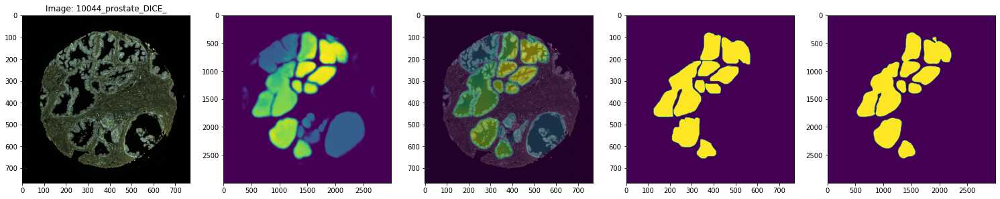

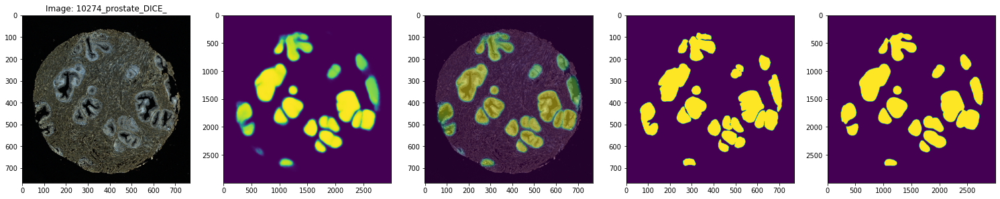

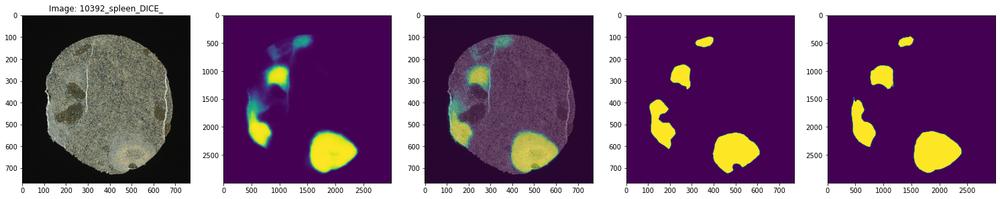

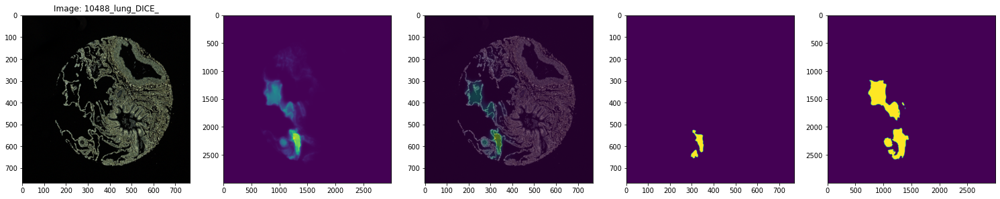

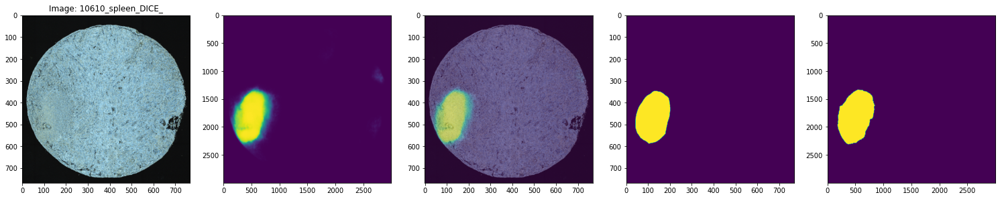

...

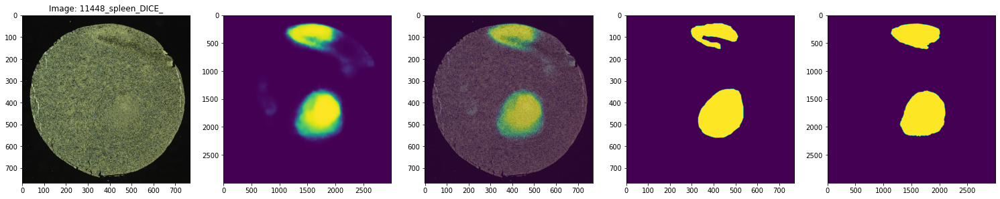

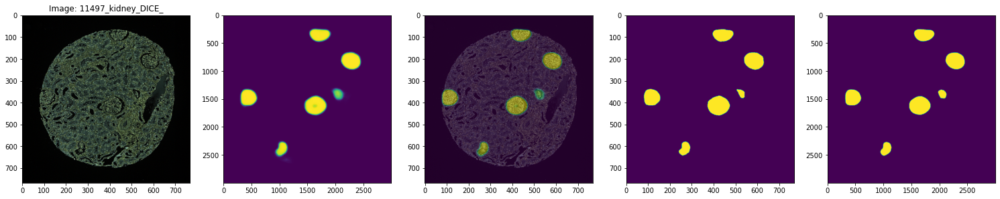

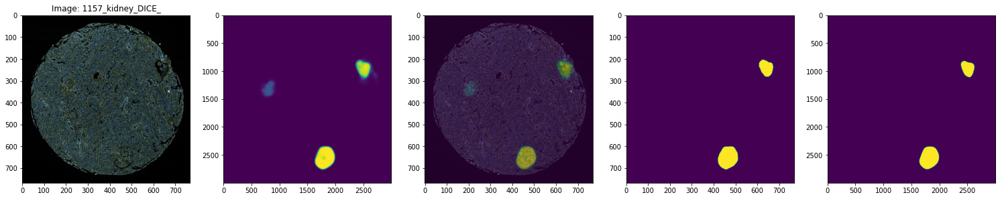

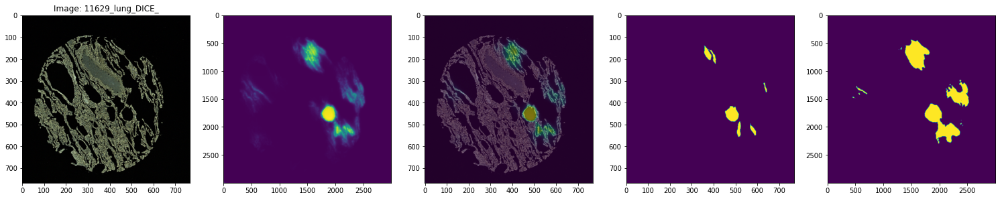

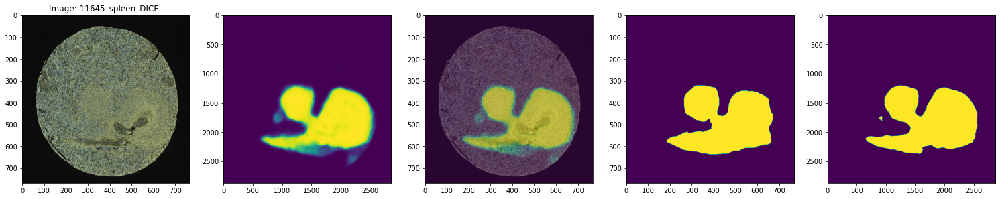

In [39]:
visual_analysis(ensemble_model, 20, 'model_768_Final')

[INFO]: Visual analysis model Best Model


  0%|          | 0/15 [00:00<?, ?it/s]

[INFO]: Visual analysis model model_768_0


  0%|          | 0/15 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[INFO]: Visual analysis model model_768_1


  0%|          | 0/15 [00:00<?, ?it/s]

[INFO]: Visual analysis model model_768_2


  0%|          | 0/15 [00:00<?, ?it/s]

[INFO]: Visual analysis model model_768_3


  0%|          | 0/15 [00:00<?, ?it/s]

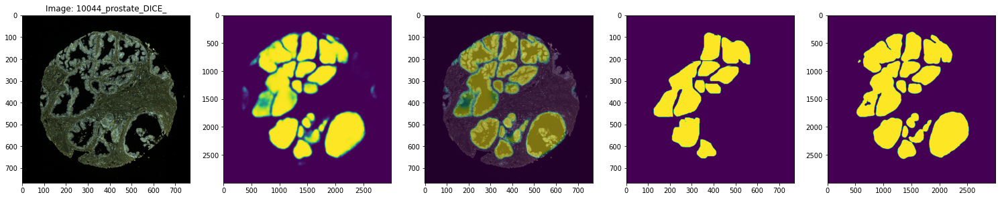

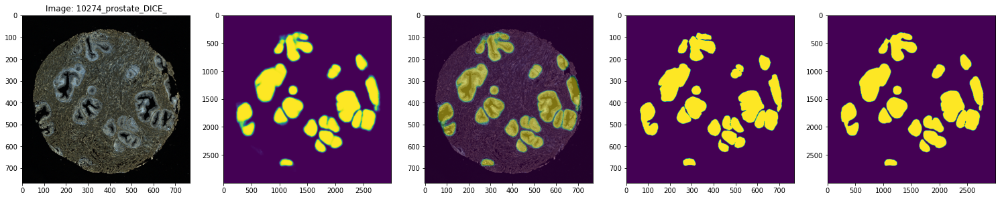

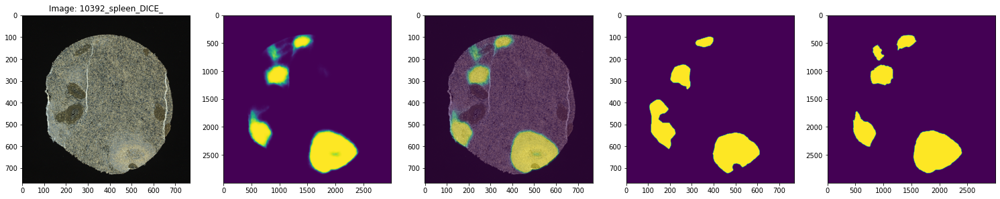

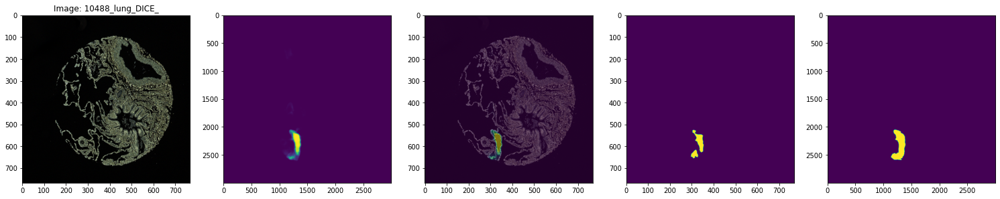

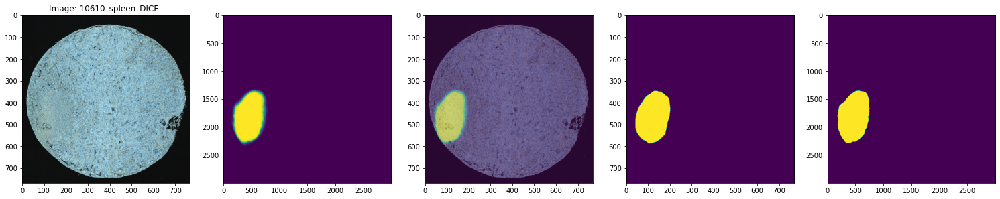

...

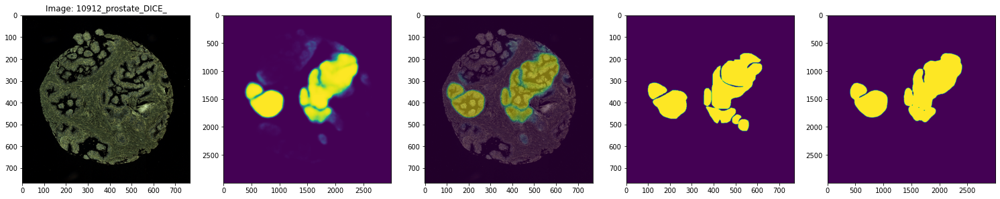

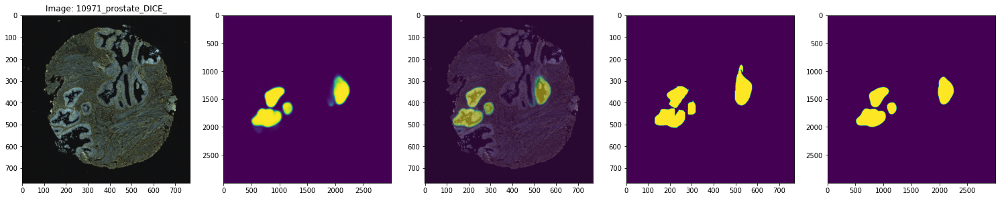

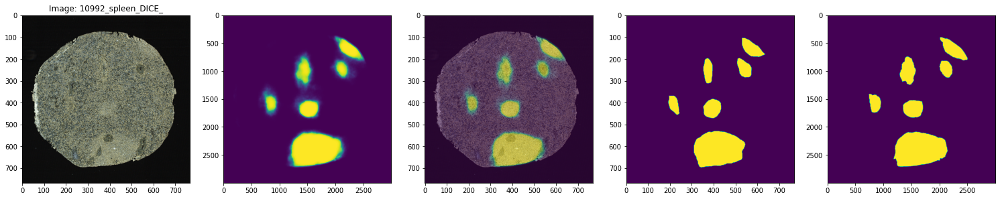

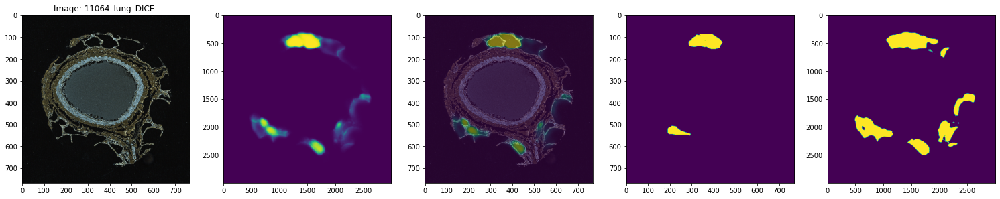

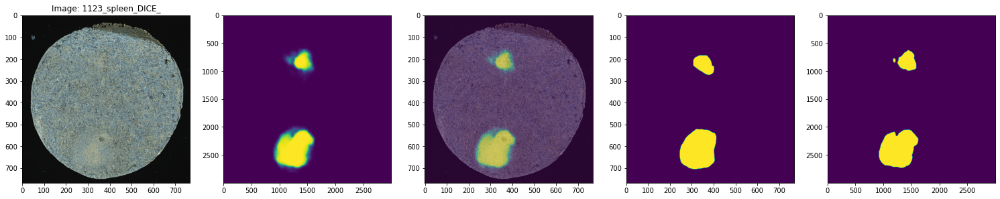

In [41]:
visual_analysis(best_model, 15, 'Best Model')
visual_analysis(model_768_0 , 15, 'model_768_0')
visual_analysis(model_768_1, 15, 'model_768_1')
visual_analysis(model_768_2, 15, 'model_768_2')
visual_analysis(model_768_3, 15, 'model_768_3')

# Inference Loop

In [42]:
def get_predictions(model):
    # Predictions are stored as a list of dictionaries
    test_rows = []

    # Iterate over all test images
    for row_idx, row in tqdm(test.iterrows(), total=len(test)):
        # Preprocess Image
        organ = row['organ']
        data_source = row['data_source']
        image, image_size = get_image(row['id'], 'test')
        image_patches = extract_patches(image)
        print()
        # Make Prediction
        mask_patches_pred = model.predict(image_patches)
        # Merge patches
        mask_pred = merge_patches(mask_patches_pred)
        # Resize mask to original size
        mask_pred_resized = resize_tensor(mask_pred, size=image_size, dtype=np.float32)

        if row_idx == 0:
            #fig, axes = plt.subplots(1,2, figsize=(16,8))
            #axes[0].imshow(mask_pred_resized)
            #axes[1].imshow(image)
            size = 26
            plt.figure(figsize = (size, size* 3))
            plt.subplot(131)
            plt.imshow(image)
            plt.subplot(132)
            plt.imshow(mask_pred_resized)
            plt.subplot(133)
            plt.imshow(image)
            plt.imshow(mask_pred, alpha = 0.5) 

            plt.show()

        # Resize and Binarize Mask
        #mask_binary = (mask_pred_resized > THRESHOLD).astype(np.int8)
        mask_binary = (mask_pred_resized > ORGAN_THRESHOLD[data_source][organ]).astype(np.int8)

        if row_idx == 0:
            fig, axes = plt.subplots(1,2, figsize=(16,8))
            axes[0].imshow(mask_binary)
            axes[1].imshow(image)
            plt.show()


        # Append to Result
        test_rows.append({
            'id': row['id'],
            'rle': rle_encode_less_memory(mask_binary)
        })

        test_df = pd.DataFrame(test_rows)

    return test_df

  0%|          | 0/1 [00:00<?, ?it/s]

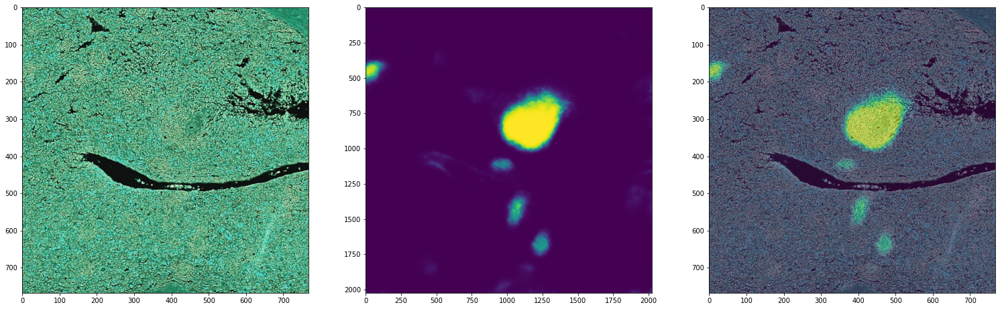

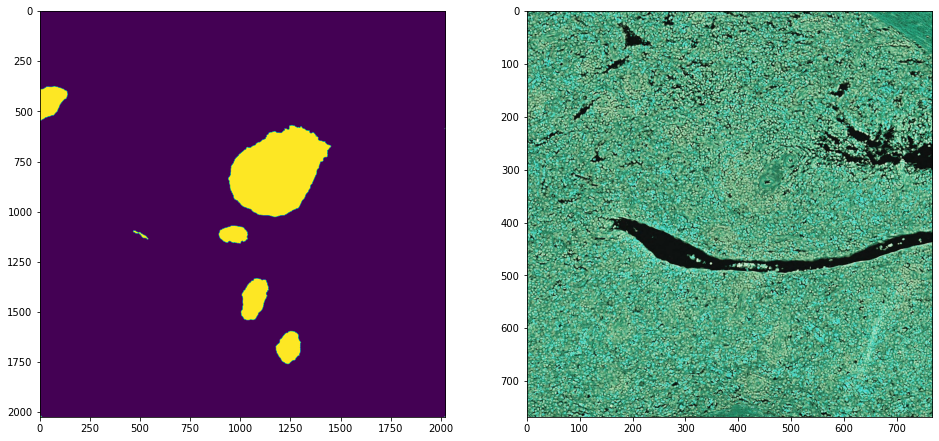

  0%|          | 0/1 [00:00<?, ?it/s]

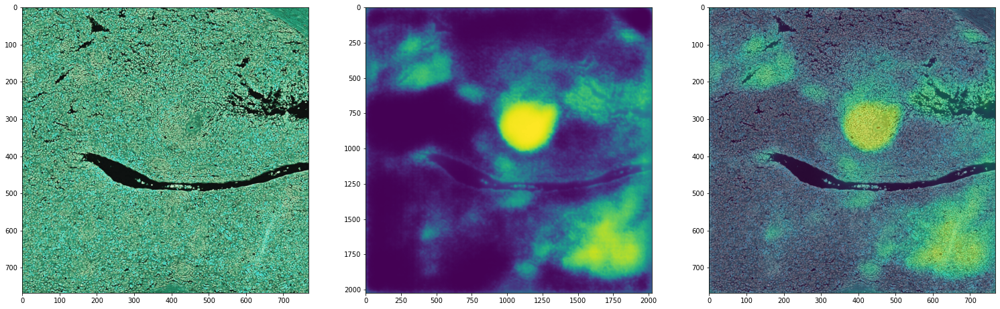

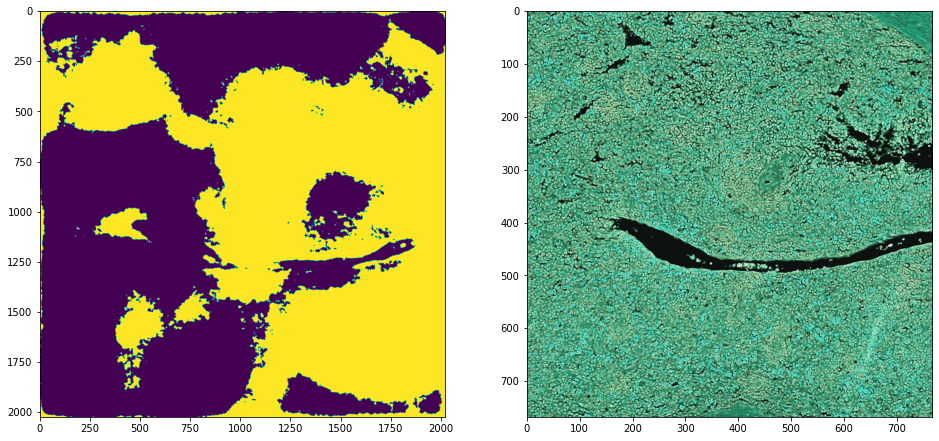

  0%|          | 0/1 [00:00<?, ?it/s]

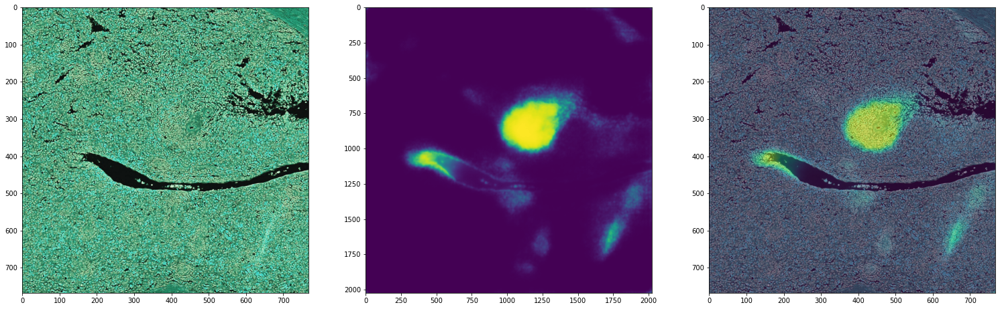

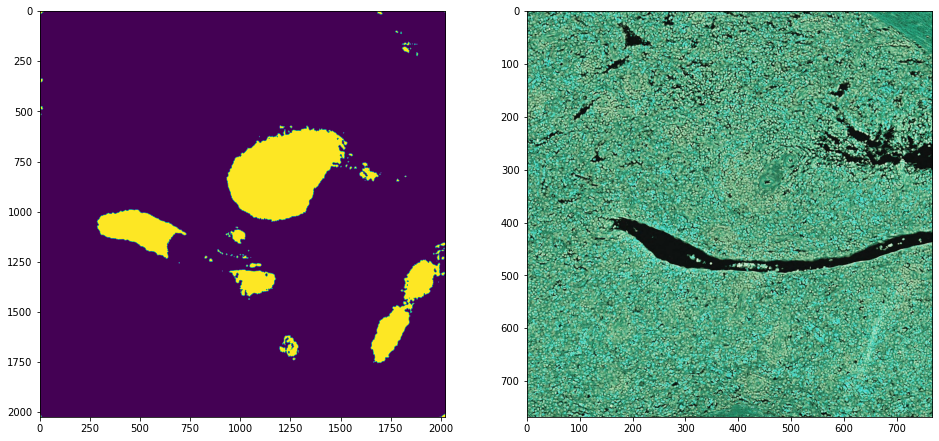

  0%|          | 0/1 [00:00<?, ?it/s]

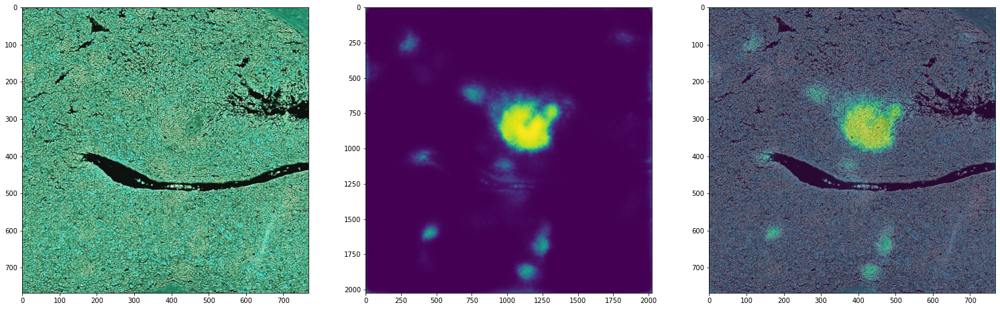

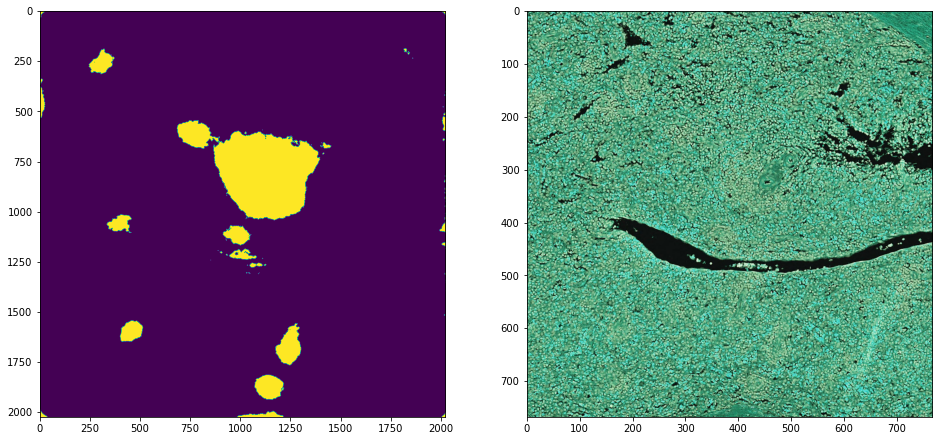

  0%|          | 0/1 [00:00<?, ?it/s]

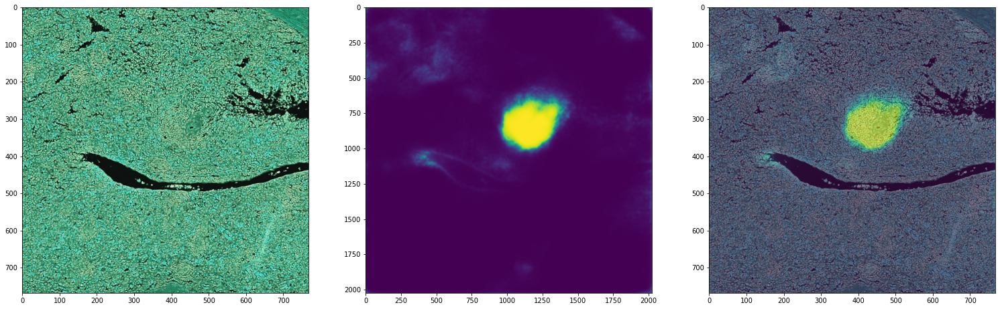

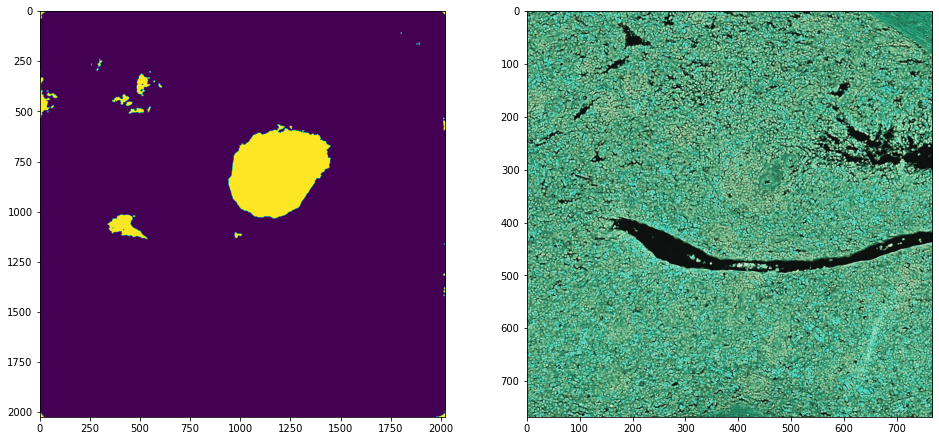

  0%|          | 0/1 [00:00<?, ?it/s]

AttributeError: 'DataFrame' object has no attribute 'predict'

In [43]:
best_model_df = get_predictions(best_model)
model_768_0_df = get_predictions(model_768_0)
model_768_1_df = get_predictions(model_768_1)
model_768_2_df = get_predictions(model_768_2)
model_768_3_df = get_predictions(model_768_3)
ensemble_model = get_predictions(ensemble_model)

# Make Submission CSV

In [35]:
# Make submission DataFrame
final_model = pd.DataFrame(best_model_df)

display(final_model .head())
display(final_model .info())

,id,rle
0,10078,2 5 389 159 2017 13 2412 159 4040 12 4435 159 ...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      1 non-null      int64 
 1   rle     1 non-null      object
dtypes: int64(1), object(1)
memory usage: 144.0+ bytes


None

In [36]:
# Write Submission CSV
final_model.to_csv('submission.csv', index=False)